In [1]:
%matplotlib notebook

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import glasbey

from sklearn.feature_extraction.text import TfidfVectorizer

import time
import pickle

import memory_profiler

%load_ext memory_profiler

from pathlib import Path

In [2]:
import black
import jupyter_black

jupyter_black.load(line_length=79)

In [3]:
%load_ext autoreload
%autoreload 2

# import pubmed_landscape_src
from pubmed_landscape_src.plotting import (
    improved_coloring,
    years_coloring,
    plot_tsne_colors,
    plot_label_tags,
    plot_tsne_years,
)

In [4]:
variables_path = Path("../../results/variables/2024_baseline")
figures_path = Path("../../results/figures/2024_baseline")
berenslab_data_path = Path("/gpfs01/berens/data/data/pubmed_processed")

In [5]:
plt.style.use("../matplotlib_style.txt")

# Colors

# Import data

In [6]:
%%time
%%memit
# import clean_2024_df
clean_2024_df = pd.read_pickle(variables_path / "clean_2024_df")

peak memory: 66840.59 MiB, increment: 66433.67 MiB
CPU times: user 58.1 s, sys: 46.5 s, total: 1min 44s
Wall time: 1min 44s


In [7]:
clean_2024_df.head()

,PMID,Title,AbstractText,Language,Journal,Date,NameFirstAuthor,NameLastAuthor,ISSN,AffiliationFirstAuthor,AffiliationLastAuthor,filename
21,24,Influence of a new virostatic compound on the ...,"The virostatic compound N,N-diethyl-4-[2-(2-ox...",eng,Arzneimittel-Forschung,1975 Sep,H,G,0004-4172,,,pubmed24n0001.xml
22,23,Effect of etafenone on total and regional myoc...,The distribution of blood flow to the subendoc...,eng,Arzneimittel-Forschung,1975 Sep,H,W,0004-4172,,,pubmed24n0001.xml
24,25,Pharmacological properties of new neuroleptic ...,"RMI 61 140, RMI 61 144 and RMI 61 280 are newl...",eng,Arzneimittel-Forschung,1975 Sep,L,A,0004-4172,,,pubmed24n0001.xml
29,30,Lysosomal hydrolases of the epidermis. I. Glyc...,Seven distinct glycosidases (EC 3.2) have been...,eng,The British journal of dermatology,1975 Jul,P D,J J,0007-0963,,,pubmed24n0001.xml
31,32,A serum haemagglutinating property dependent u...,A serum agglutinin reactive with red cells in ...,eng,British journal of haematology,1975 Jan,M L,W L,0007-1048,,,pubmed24n0001.xml


In [6]:
# load
# legend colors
pickle_in = open("../../results/variables/colors_new_legend.pkl", "rb")
colors_new_legend = pickle.load(pickle_in)

In [22]:
tsne = np.load(variables_path / "tsne_bert_sep.npy")

In [23]:
tsne_rot = np.vstack((-tsne[:, 1], -tsne[:, 0])).T

# Colors based on journal keywords

In [10]:
%%time
labels_2024, colors_2024 = improved_coloring(clean_2024_df.Journal, colors_new_legend)

In [15]:
# save results
np.save(variables_path / "labels_2024", labels_2024)
np.save(variables_path / "colors_2024", colors_2024)

# save results
f = open(variables_path / "colors_2024_legend.pkl", "wb")
pickle.dump(colors_new_legend, f)
f.close()

In [12]:
labels_2024

array(['unlabeled', 'unlabeled', 'unlabeled', ..., 'unlabeled',
       'unlabeled', 'nursing'], dtype='<U32')

### Add Dentistry as label

In [7]:
# load
# legend colors
pickle_in = open(variables_path / "colors_2024_legend.pkl", "rb")
colors_2024_legend = pickle.load(pickle_in)

# colors
colors_2024 = np.load(variables_path / "colors_2024.npy", allow_pickle=True)

In [8]:
colors_2024_legend

{'cancer': 'black',
 'neuroscience': '#aeaa00',
 'cardiology': '#1CE6FF',
 'ecology': '#FF34FF',
 'bioinformatics': '#FF4A46',
 'chemistry': '#008941',
 'surgery': '#006FA6',
 'environment': '#0089A3',
 'material': '#0000A6',
 'microbiology': '#B79762',
 'pediatric': '#004D43',
 'immunology': '#8FB0FF',
 'psychology': '#5A0007',
 'psychiatry': '#BA0900',
 'genetics': '#1B4400',
 'nutrition': '#4FC601',
 'veterinary': '#3B5DFF',
 'engineering': '#00C2A0',
 'education': '#549E79',
 'physics': '#BC23FF',
 'optics': '#C895C5',
 'nursing': '#FF2F80',
 'neurology': '#009271',
 'radiology': '#00FECF',
 'ophthalmology': '#A4E804',
 'gynecology': '#FFB500',
 'rehabilitation': '#6B002C',
 'pathology': '#FF9408',
 'anesthesiology': '#CC0744',
 'dermatology': '#D790FF',
 'pharmacology': '#5B4534',
 'physiology': '#E83000',
 'virology': '#6F0062',
 'biochemistry': '#b65141',
 'computation': '#C20078',
 'infectious': '#7A4900',
 'healthcare': '#FF90C9',
 'ethics': '#6508ba'}

['#8675ba', '#757500', '#8e4d8a']

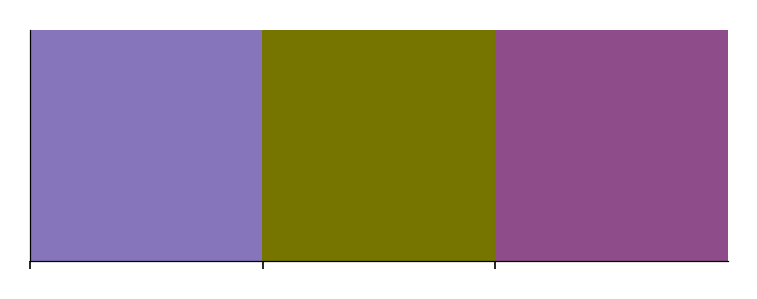

In [26]:
colormap = glasbey.extend_palette(
    list(colors_new_legend.values()),
    palette_size=len(colors_new_legend) + 3,
    lightness_bounds=(20, 75),
    chroma_bounds=(40, 90),
)

sns.palplot(colormap[-3:])
colormap[-3:]

In [9]:
colors_new_legend_with_dentistry = colors_2024_legend.copy()
colors_new_legend_with_dentistry["dentistry"] = "#8e4d8a"

In [10]:
colors_new_legend_with_dentistry

{'cancer': 'black',
 'neuroscience': '#aeaa00',
 'cardiology': '#1CE6FF',
 'ecology': '#FF34FF',
 'bioinformatics': '#FF4A46',
 'chemistry': '#008941',
 'surgery': '#006FA6',
 'environment': '#0089A3',
 'material': '#0000A6',
 'microbiology': '#B79762',
 'pediatric': '#004D43',
 'immunology': '#8FB0FF',
 'psychology': '#5A0007',
 'psychiatry': '#BA0900',
 'genetics': '#1B4400',
 'nutrition': '#4FC601',
 'veterinary': '#3B5DFF',
 'engineering': '#00C2A0',
 'education': '#549E79',
 'physics': '#BC23FF',
 'optics': '#C895C5',
 'nursing': '#FF2F80',
 'neurology': '#009271',
 'radiology': '#00FECF',
 'ophthalmology': '#A4E804',
 'gynecology': '#FFB500',
 'rehabilitation': '#6B002C',
 'pathology': '#FF9408',
 'anesthesiology': '#CC0744',
 'dermatology': '#D790FF',
 'pharmacology': '#5B4534',
 'physiology': '#E83000',
 'virology': '#6F0062',
 'biochemistry': '#b65141',
 'computation': '#C20078',
 'infectious': '#7A4900',
 'healthcare': '#FF90C9',
 'ethics': '#6508ba',
 'dentistry': '#8e4d8a'}

In [17]:
%%time
labels_2024_with_dentistry, colors_2024_with_dentistry = improved_coloring(
    clean_2024_df.Journal, colors_new_legend_with_dentistry
)

CPU times: user 15min 54s, sys: 46.8 s, total: 16min 41s
Wall time: 16min 41s


In [18]:
# save results
np.save(
    variables_path / "labels_2024_with_dentistry", labels_2024_with_dentistry
)
np.save(
    variables_path / "colors_2024_with_dentistry", colors_2024_with_dentistry
)

# save results
f = open(variables_path / "colors_2024_legend_with_dentistry.pkl", "wb")
pickle.dump(colors_new_legend_with_dentistry, f)
f.close()

In [19]:
labels_2024_with_dentistry

array(['unlabeled', 'unlabeled', 'unlabeled', ..., 'unlabeled',
       'unlabeled', 'nursing'], dtype='<U32')

In [20]:
np.sum(labels_2024_with_dentistry == "dentistry")

75633

## Plot

### With old labels

In [8]:
# load
# legend colors
pickle_in = open(variables_path / "colors_2024_legend.pkl", "rb")
colors_2024_legend = pickle.load(pickle_in)

colors_2024 = np.load(variables_path / "colors_2024.npy", allow_pickle=True)

/gpfs01/berens/user/rgonzalesmarquez/phd/pubmed-landscape/pubmed_landscape_src/plotting.py:436: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ax.plot([x[i],center_cluster_coordinates_left.x[i]],[y[i],center_cluster_coordinates_left.y[i]], c=colr, linewidth=0.4, clip_on=False)
/gpfs01/berens/user/rgonzalesmarquez/phd/pubmed-landscape/pubmed_landscape_src/plotting.py:432: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ax.plot([x[i],center_cluster_coordinates_left.x[i]],[y[i],center_cluster_coordinates_left.y[i]], c=colr, linewidth=0.4, clip_on=False)
/gpfs01/berens/user/rgonzalesmarquez/phd/pubmed-landscape/pubmed_lands

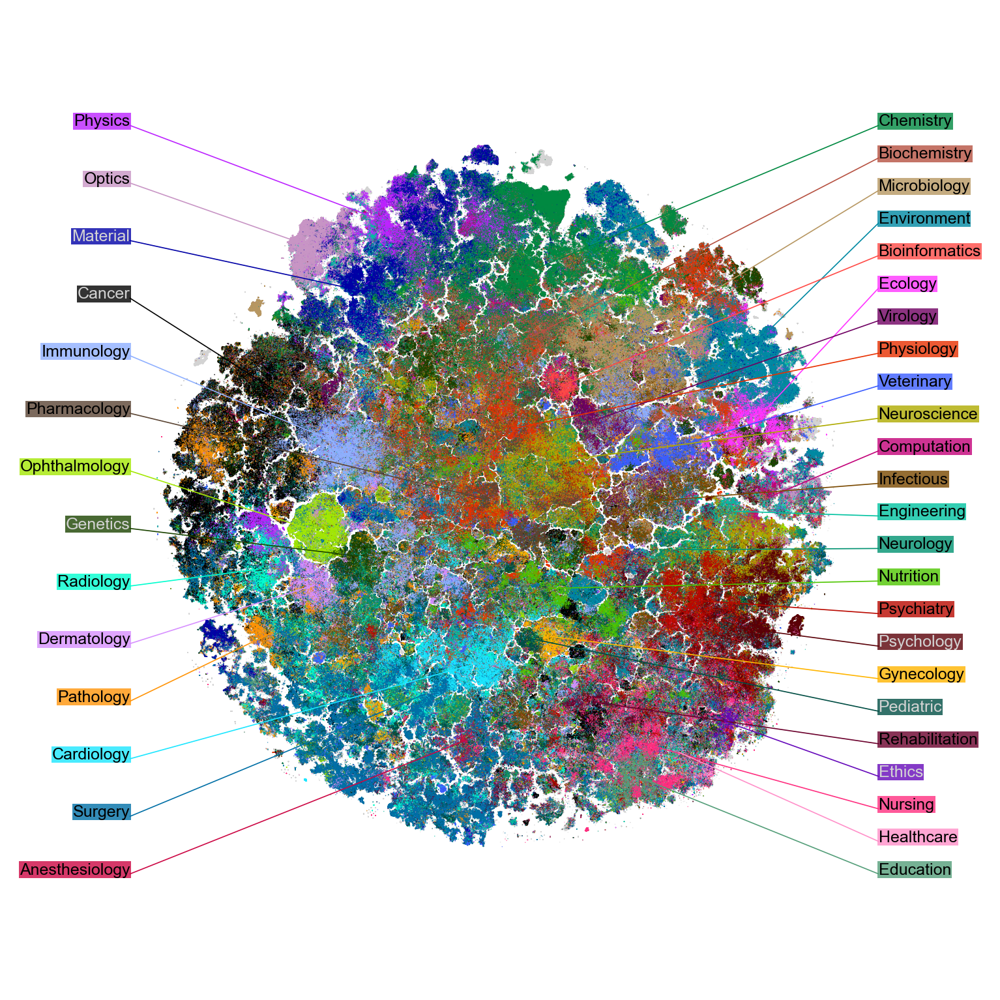

In [17]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5, 5), dpi=300, layout="constrained")

txtkwargs = dict(size=8, weight="bold", va="top", ha="left")
x_lim = (-230, 230)
y_lim = (-230, 230)

plot_tsne_colors(
    tsne, colors_2024, x_lim=x_lim, y_lim=y_lim, ax=ax, plot_type=None
)
plot_label_tags(
    tsne,
    colors_2024,
    colors_new_legend,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    fontsize=6,
    rs=2,
)

fig.savefig(figures_path / "tsne_colored_by_labels.png")

/gpfs01/berens/user/rgonzalesmarquez/phd/pubmed-landscape/pubmed_landscape_src/plotting.py:432: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ax.plot([x[i],center_cluster_coordinates_left.x[i]],[y[i],center_cluster_coordinates_left.y[i]], c=colr, linewidth=0.4, clip_on=False)
/gpfs01/berens/user/rgonzalesmarquez/phd/pubmed-landscape/pubmed_landscape_src/plotting.py:436: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ax.plot([x[i],center_cluster_coordinates_left.x[i]],[y[i],center_cluster_coordinates_left.y[i]], c=colr, linewidth=0.4, clip_on=False)
/gpfs01/berens/user/rgonzalesmarquez/phd/pubmed-landscape/pubmed_lands

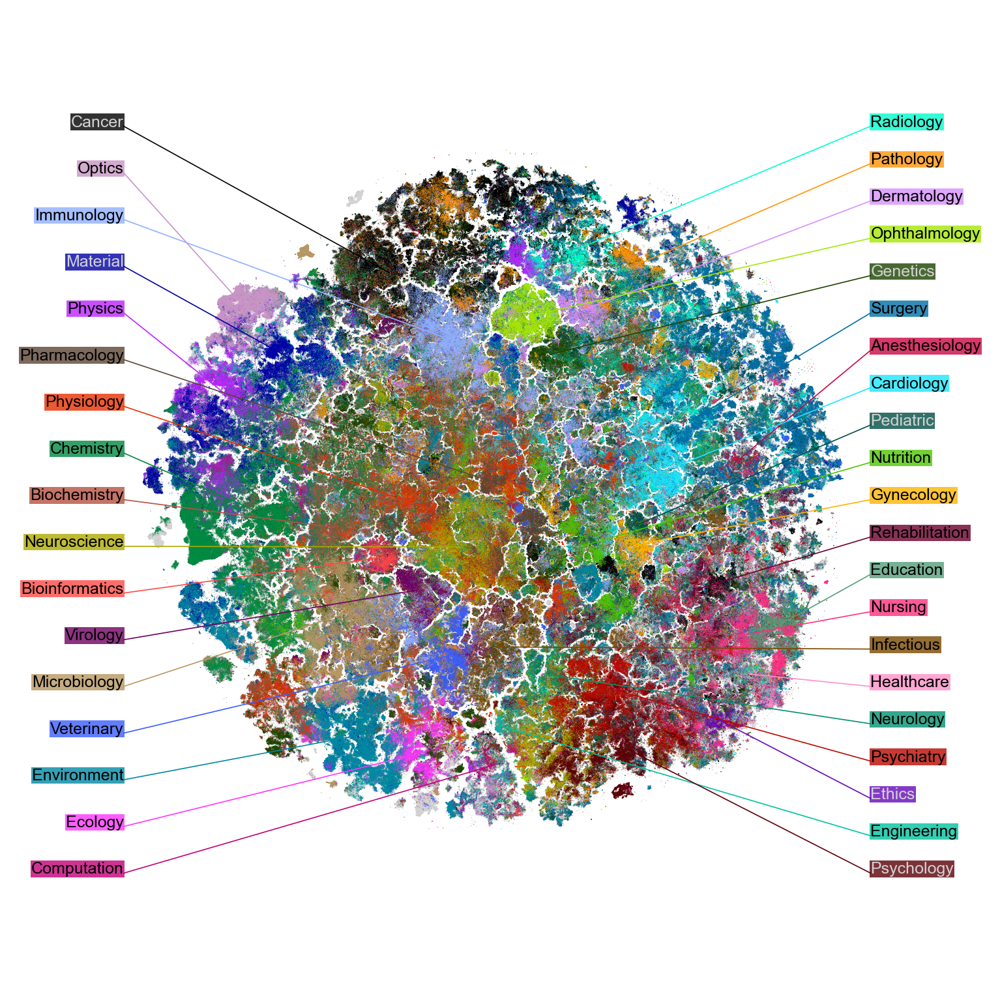

In [66]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5, 5), dpi=300, layout="constrained")

txtkwargs = dict(size=8, weight="bold", va="top", ha="left")
x_lim = (-230, 230)
y_lim = (-230, 230)


plot_tsne_colors(
    tsne_rot,
    colors_2024,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="subplot_2",
)
plot_label_tags(
    tsne_rot,
    colors_2024,
    colors_new_legend,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    fontsize=6,
    rs=2,
)

fig.savefig(figures_path / "tsne_colored_by_labels_v4.png")

### With dentistry

/gpfs01/berens/user/rgonzalesmarquez/phd/pubmed-landscape/pubmed_landscape_src/plotting.py:432: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ax.plot([x[i],center_cluster_coordinates_left.x[i]],[y[i],center_cluster_coordinates_left.y[i]], c=colr, linewidth=0.4, clip_on=False)
/gpfs01/berens/user/rgonzalesmarquez/phd/pubmed-landscape/pubmed_landscape_src/plotting.py:436: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ax.plot([x[i],center_cluster_coordinates_left.x[i]],[y[i],center_cluster_coordinates_left.y[i]], c=colr, linewidth=0.4, clip_on=False)
/gpfs01/berens/user/rgonzalesmarquez/phd/pubmed-landscape/pubmed_lands

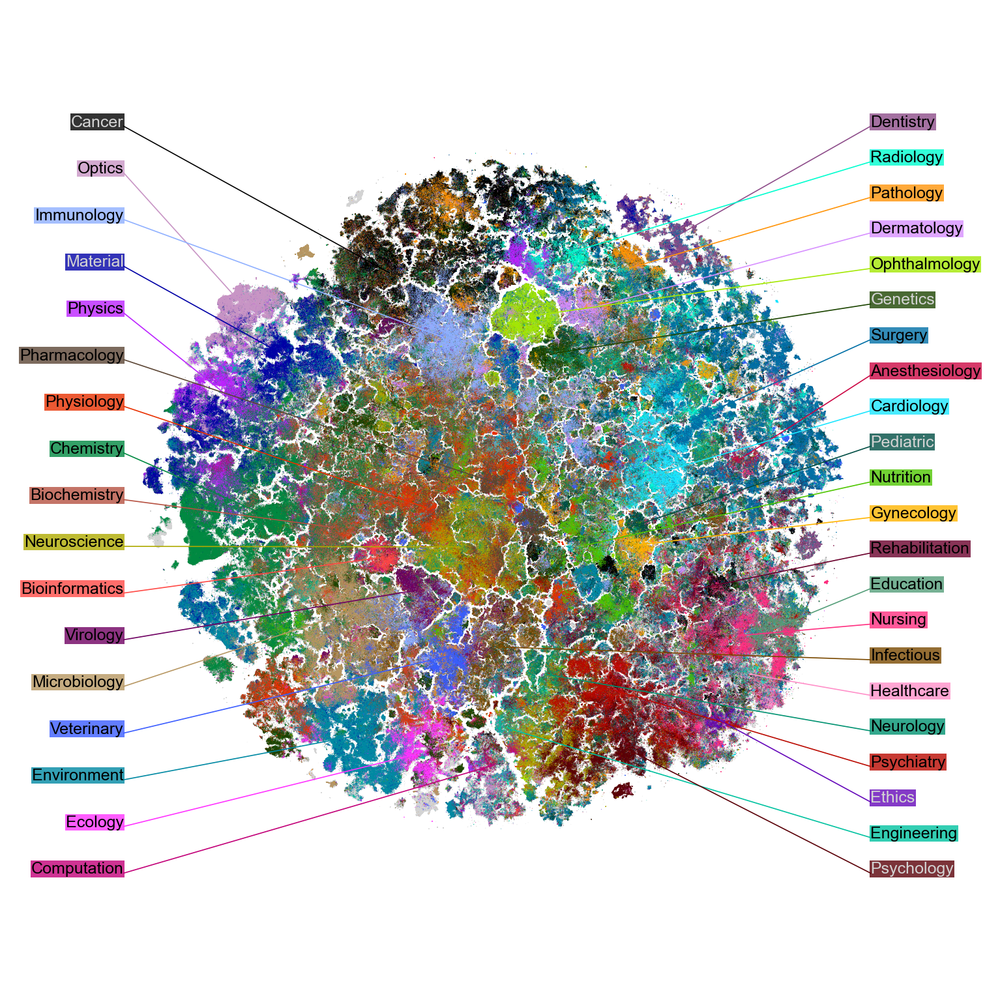

In [29]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5, 5), dpi=300, layout="constrained")

txtkwargs = dict(size=8, weight="bold", va="top", ha="left")
x_lim = (-230, 230)
y_lim = (-230, 230)


plot_tsne_colors(
    tsne_rot,
    colors_2024_with_dentistry_2,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="subplot_2",
)
plot_label_tags(
    tsne_rot,
    colors_2024_with_dentistry_2,
    colors_new_legend_with_dentistry,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    fontsize=6,
    rs=2,
)

fig.savefig(figures_path / "tsne_colored_by_labels_with_dentistry_v2.png")

### Next to 2021 baseline t-SNE embedding

In [9]:
variables_path_old = Path("../../results/variables")

In [10]:
tsne_reparsed = np.load(variables_path_old / "tsne_reparsed.npy")

In [11]:
tsne_old = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

In [12]:
# load
# legend colors
pickle_in = open(variables_path_old / "colors_new_legend.pkl", "rb")
colors_new_legend = pickle.load(pickle_in)

colors_new = np.load(variables_path_old / "colors_new.npy", allow_pickle=True)

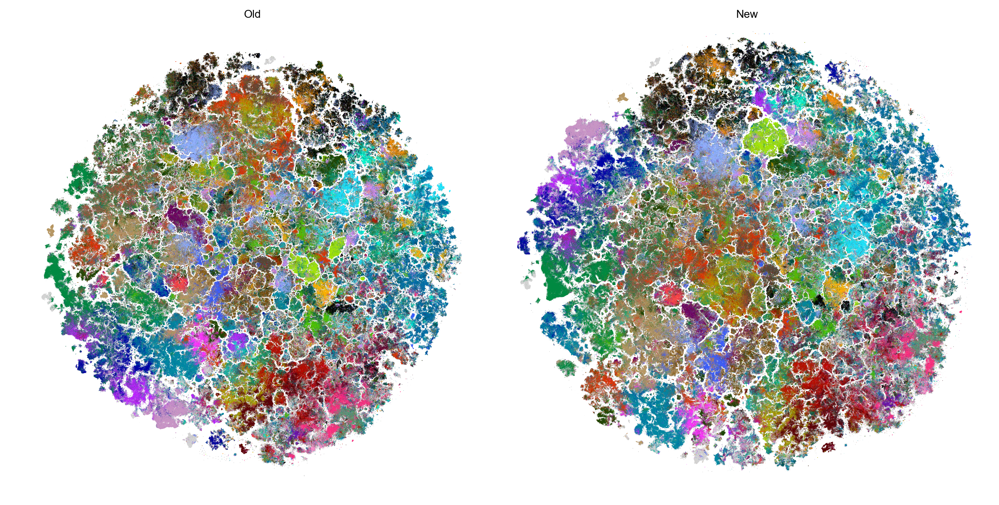

In [16]:
%matplotlib inline

fig, ax = plt.subplots(1, 2, figsize=(10, 5), dpi=300, layout="constrained")

txtkwargs = dict(size=8, weight="bold", va="top", ha="left")
x_lim = (-230, 230)
y_lim = (-230, 230)

plot_tsne_colors(
    tsne_old,
    colors_new,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax[0],
    plot_type="subplot_2",
)
ax[0].set_title("Old")

plot_tsne_colors(
    tsne_rot,
    colors_2024,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax[1],
    plot_type="subplot_2",
)
ax[1].set_title("New")


fig.savefig(figures_path / "both_tsne_colored_by_labels_v2.png")

# Colors by year of publication

In [8]:
# Date
all_dates = clean_2024_df["Date"]
unique_dates = np.unique(all_dates)

In [9]:
# Example of how the dates look like
print(unique_dates[20000:20010])

['2008 Aug 25' '2008 Aug 26' '2008 Aug 26-Sep 1' '2008 Aug 27'
 '2008 Aug 27-Sep 2' '2008 Aug 28' '2008 Aug 29' '2008 Aug 30'
 '2008 Aug 31' '2008 Aug 5-11']


In [10]:
%%time

# We do this to get the vocabulary, that divides the date strings in their different words

vectorizer = TfidfVectorizer(sublinear_tf=True)
tfidf_dates = vectorizer.fit_transform(unique_dates)
vocabulary_dates = vectorizer.vocabulary_

CPU times: user 108 ms, sys: 8.05 ms, total: 116 ms
Wall time: 122 ms


In [11]:
dates_list = list(vocabulary_dates.keys())
len_dates_list = map(len, dates_list)
len_dates = np.fromiter(len_dates_list, dtype=np.int64, count=len(dates_list))

dates_list = np.array(dates_list)
years = dates_list[len_dates == 4]
print(list(years))

['1808', '1876', '1881', '1883', '1891', '1896', '1897', '1898', '1899', '1900', '1901', '1902', '1903', '1905', '1906', '1907', '1908', '1909', '1910', '1911', '1912', '1913', '1914', '1915', '1916', '1917', '1918', '1919', '1920', '1921', '1922', '1923', '1924', '1925', '1926', '1927', '1928', '1929', '1930', '1931', '1932', '1933', '1934', '1935', '1936', '1937', '1938', '1939', '1940', '1941', '1942', '1943', '1944', '1945', '1946', '1947', '1948', '1949', '1950', '1951', '1952', '1953', '1954', '1955', '1956', '1957', '1958', '1959', '1960', '1961', '1962', '1963', '1964', '1965', '1966', '1967', '1968', 'fall', '1969', '1970', '1971', '1972', '1973', '1974', '1975', '1976', '1977', '1978', '1979', '1980', '1981', '1982', '1983', '1984', '1985', '1986', '1987', '1988', '1989', '1990', '1991', '1992', '1993', '1994', '1995', 'june', 'july', '1996', '1997', '1998', '1999', '2000', '2004', '2001', '2002', '2003', '2005', '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013',

In [12]:
# select only years
years = [elem for elem in years if (elem[0] == "1") | (elem[0] == "2")]
print(years)

['1808', '1876', '1881', '1883', '1891', '1896', '1897', '1898', '1899', '1900', '1901', '1902', '1903', '1905', '1906', '1907', '1908', '1909', '1910', '1911', '1912', '1913', '1914', '1915', '1916', '1917', '1918', '1919', '1920', '1921', '1922', '1923', '1924', '1925', '1926', '1927', '1928', '1929', '1930', '1931', '1932', '1933', '1934', '1935', '1936', '1937', '1938', '1939', '1940', '1941', '1942', '1943', '1944', '1945', '1946', '1947', '1948', '1949', '1950', '1951', '1952', '1953', '1954', '1955', '1956', '1957', '1958', '1959', '1960', '1961', '1962', '1963', '1964', '1965', '1966', '1967', '1968', '1969', '1970', '1971', '1972', '1973', '1974', '1975', '1976', '1977', '1978', '1979', '1980', '1981', '1982', '1983', '1984', '1985', '1986', '1987', '1988', '1989', '1990', '1991', '1992', '1993', '1994', '1995', '1996', '1997', '1998', '1999', '2000', '2004', '2001', '2002', '2003', '2005', '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016',

In [51]:
# save
np.save(variables_path / "years_2024", years)

In [13]:
# dicctionary years(number):color value

length_interval = 2024 - 1970
cmap_values = np.linspace(0, 1, length_interval + 1)
year_numbers_list = np.arange(1970, 2025).tolist()

dicc_years = dict(zip(year_numbers_list, cmap_values))
dicc_years

{1970: 0.0,
 1971: 0.018518518518518517,
 1972: 0.037037037037037035,
 1973: 0.05555555555555555,
 1974: 0.07407407407407407,
 1975: 0.09259259259259259,
 1976: 0.1111111111111111,
 1977: 0.12962962962962962,
 1978: 0.14814814814814814,
 1979: 0.16666666666666666,
 1980: 0.18518518518518517,
 1981: 0.2037037037037037,
 1982: 0.2222222222222222,
 1983: 0.24074074074074073,
 1984: 0.25925925925925924,
 1985: 0.2777777777777778,
 1986: 0.2962962962962963,
 1987: 0.31481481481481477,
 1988: 0.3333333333333333,
 1989: 0.35185185185185186,
 1990: 0.37037037037037035,
 1991: 0.38888888888888884,
 1992: 0.4074074074074074,
 1993: 0.42592592592592593,
 1994: 0.4444444444444444,
 1995: 0.4629629629629629,
 1996: 0.48148148148148145,
 1997: 0.5,
 1998: 0.5185185185185185,
 1999: 0.537037037037037,
 2000: 0.5555555555555556,
 2001: 0.5740740740740741,
 2002: 0.5925925925925926,
 2003: 0.611111111111111,
 2004: 0.6296296296296295,
 2005: 0.6481481481481481,
 2006: 0.6666666666666666,
 2007: 0.68518

In [14]:
# save results
f = open(variables_path / "legend_years_2024.pkl", "wb")
pickle.dump(dicc_years, f)
f.close()

MEDLINE started its record in 1966 and later included almost 60 thousand noteworthy papers previously published. Therefore, the majority of the papers from PubMed are post 1970, so we used a color map going from blue (1970) to yellow (2022) and all of the papers dated before 1970 were also colored in the darkest hue of blue.

In [15]:
# We manually set papers dated from before 1970 to 0 (equivalent to the darkest hue).

years_int = np.array([int(elem) for elem in years])
years_out = years_int[years_int < 1970]
print(years_out)

for elem in years_out:
    dicc_years[elem] = 0

[1808 1876 1881 1883 1891 1896 1897 1898 1899 1900 1901 1902 1903 1905
 1906 1907 1908 1909 1910 1911 1912 1913 1914 1915 1916 1917 1918 1919
 1920 1921 1922 1923 1924 1925 1926 1927 1928 1929 1930 1931 1932 1933
 1934 1935 1936 1937 1938 1939 1940 1941 1942 1943 1944 1945 1946 1947
 1948 1949 1950 1951 1952 1953 1954 1955 1956 1957 1958 1959 1960 1961
 1962 1963 1964 1965 1966 1967 1968 1969]


In [16]:
dicc_years

{1970: 0.0,
 1971: 0.018518518518518517,
 1972: 0.037037037037037035,
 1973: 0.05555555555555555,
 1974: 0.07407407407407407,
 1975: 0.09259259259259259,
 1976: 0.1111111111111111,
 1977: 0.12962962962962962,
 1978: 0.14814814814814814,
 1979: 0.16666666666666666,
 1980: 0.18518518518518517,
 1981: 0.2037037037037037,
 1982: 0.2222222222222222,
 1983: 0.24074074074074073,
 1984: 0.25925925925925924,
 1985: 0.2777777777777778,
 1986: 0.2962962962962963,
 1987: 0.31481481481481477,
 1988: 0.3333333333333333,
 1989: 0.35185185185185186,
 1990: 0.37037037037037035,
 1991: 0.38888888888888884,
 1992: 0.4074074074074074,
 1993: 0.42592592592592593,
 1994: 0.4444444444444444,
 1995: 0.4629629629629629,
 1996: 0.48148148148148145,
 1997: 0.5,
 1998: 0.5185185185185185,
 1999: 0.537037037037037,
 2000: 0.5555555555555556,
 2001: 0.5740740740740741,
 2002: 0.5925925925925926,
 2003: 0.611111111111111,
 2004: 0.6296296296296295,
 2005: 0.6481481481481481,
 2006: 0.6666666666666666,
 2007: 0.68518

In [17]:
%%time

colors_per_year_2024, date_year = years_coloring(
    clean_2024_df["Date"], years, dicc_years
)

CPU times: user 22min 33s, sys: 36.3 s, total: 23min 9s
Wall time: 23min 10s


In [62]:
# save
np.save(variables_path / "colors_per_year_2024", colors_per_year_2024)

In [18]:
# save
np.save(variables_path / "date_year_2024", date_year)

### Plot

In [64]:
# save
colors_per_year_2024 = np.load(variables_path / "colors_per_year_2024.npy")

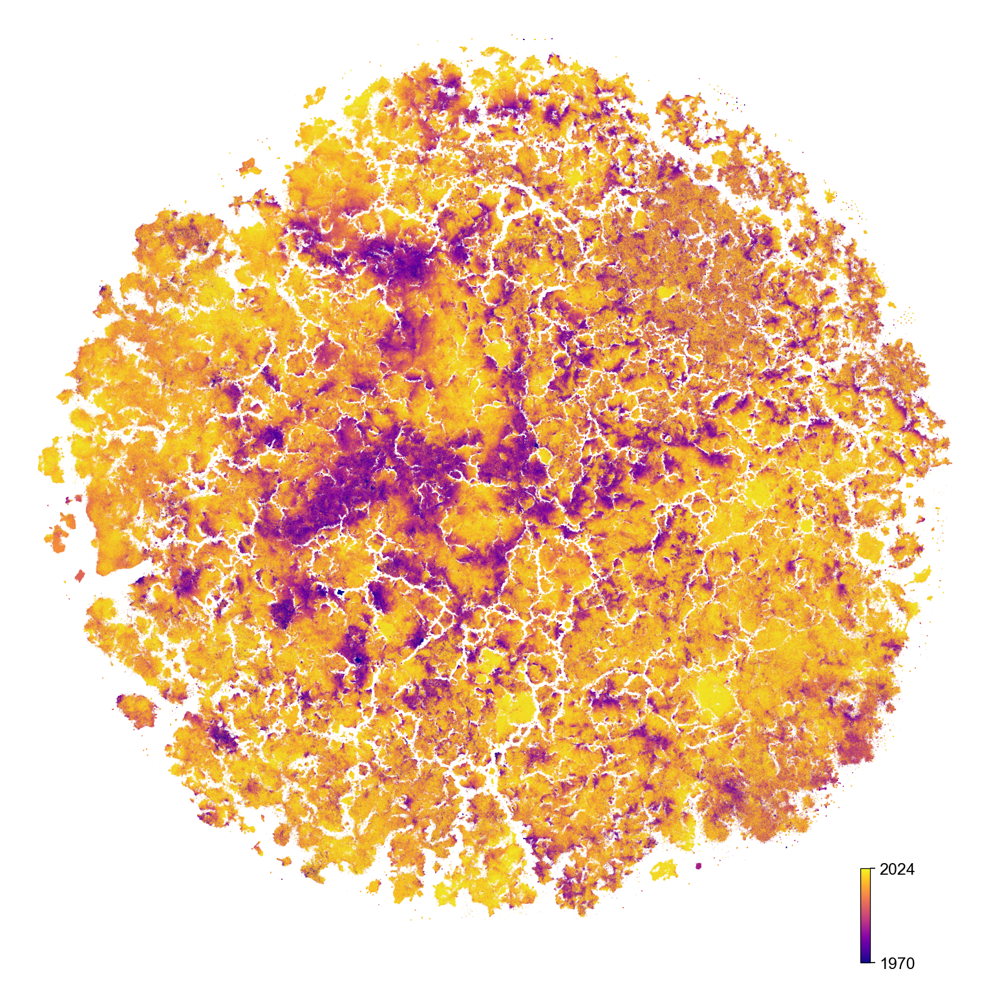

In [65]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5, 5), dpi=300, layout="constrained")

txtkwargs = dict(size=8, weight="bold", va="top", ha="left")
x_lim = (-230, 230)
y_lim = (-230, 230)

plot_tsne_years(
    tsne_rot,
    colors_per_year_2024,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    fontsize=6,
    colorbar=True,
    top_year="2024",
)

fig.savefig(figures_path / "tsne_colored_by_years.png")